In [1]:
#import basic library
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from time import time as t

from model.edsr import edsr
from model.K2R2 import K2R2
from model.TCsr import TCsr

import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.optimizers import Adam
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

%matplotlib inline

2022-05-31 00:30:42.510345: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


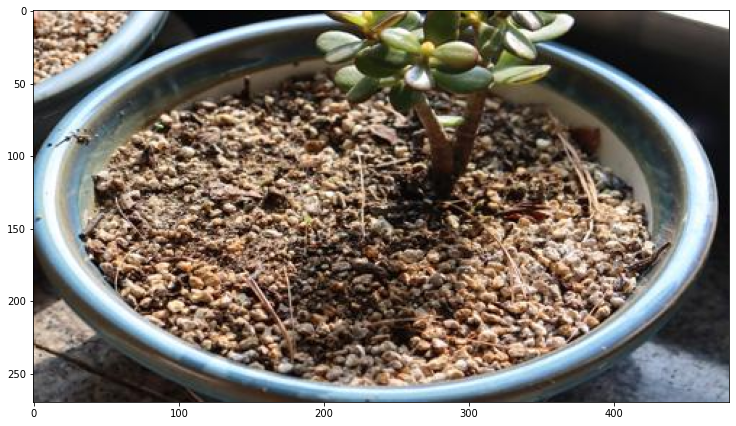

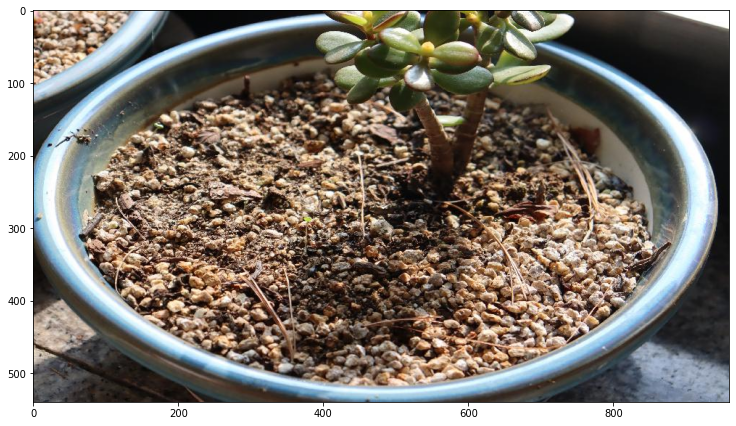

In [2]:
#show image
X_train_path = "./DL_data/img_data_LR"
y_train_path = "./DL_data/img_data_HR"
X_test_path = "./DL_data/img_data_LR_test"
y_test_path = "./DL_data/img_data_HR_test"

X_train_data_dir = sorted(os.listdir(X_train_path))
y_train_data_dir = sorted(os.listdir(y_train_path))
X_test_data_dir = sorted(os.listdir(X_test_path))
y_test_data_dir = sorted(os.listdir(y_test_path))

#hyperparameters
height = 540
width = 960
down_scale = 0.5

show_scale = 0.8
show_height = 9 * show_scale
show_width = 16 * show_scale

epochs = 20
num = 11

X_data_path = os.path.join(X_train_path, X_train_data_dir[num])
y_data_path = os.path.join(y_train_path, y_train_data_dir[num])

#show sample images
LR_sample = load_img(X_data_path, target_size=(int(height * down_scale), int(width * down_scale))) 
HR_sample = load_img(y_data_path, target_size=(height, width))

plt.figure(figsize=(show_width, show_height))
plt.imshow(LR_sample)

plt.figure(figsize=(show_width, show_height))
plt.imshow(HR_sample)

In [3]:
"""
X_data = np.float32(np.zeros((len(X_data_dir), int(height * down_scale), int(width * down_scale), 3)))
y_data = np.float32(np.zeros((len(X_data_dir), height, width, 3)))

for x_num, x_img in enumerate(X_data_dir):
    img_path = os.path.join(X_path, x_img)
    img = load_img(img_path, target_size=(int(height * down_scale), int(width * down_scale)))

    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    X_data[x_num, :, :, :] = x
        
for y_num, y_img in enumerate(y_data_dir):
    img_path = os.path.join(y_path, y_img)
    img = load_img(img_path, target_size=(height, width))

    y = img_to_array(img)
    y = np.expand_dims(y, axis=0)
    y_data[y_num, :, :, :] = y

R = np.mean(y_data[:,:,:,0])
G = np.mean(y_data[:,:,:,1])
B = np.mean(y_data[:,:,:,2])

data_mean = np.array([R, G, B])
"""

"""

failed code: OOM(Out Of Memory)



"""

'\n\nfailed code: OOM(Out Of Memory)\n\n\n\n'

In [4]:
#data loading
X_train_path = "./DL_data/img_data_LR"
y_train_path = "./DL_data/img_data_HR"
X_test_path = "./DL_data/img_data_LR_test"
y_test_path = "./DL_data/img_data_HR_test"

X_train_data_dir = sorted(os.listdir(X_train_path))
y_train_data_dir = sorted(os.listdir(y_train_path))
X_test_data_dir = sorted(os.listdir(X_test_path))
y_test_data_dir = sorted(os.listdir(y_test_path))

img_args_train = (X_train_path, y_train_path, X_train_data_dir, y_train_data_dir, height, width, down_scale) 
img_args_test = (X_test_path, y_test_path, X_test_data_dir, y_test_data_dir, height, width, down_scale) 

#iterable return data function
def get_datasets(*args):
    X_path, y_path, X_data_dir, y_data_dir, height, width, down_scale = args
    num_data = len(X_data_dir)
    
    for num in range(num_data):
        X_data_path = os.path.join(X_path, X_data_dir[num])
        y_data_path = os.path.join(y_path, y_data_dir[num])
        
        X_data = load_img(X_data_path, target_size=(int(height * down_scale), int(width * down_scale))) 
        y_data = load_img(y_data_path, target_size=(height, width))
        
        X_data = img_to_array(X_data)
        y_data = img_to_array(y_data)
        
        #batch size = 1
        #X_data = np.expand_dims(X_data, axis=0)
        #y_data = np.expand_dims(y_data, axis=0)
        
        yield (X_data, y_data)

data_shape = ((int(height*down_scale), int(width*down_scale), 3), (height, width, 3))
#batch size = 1
#data_shape = ((1, int(height*down_scale), int(width*down_scale), 3), (1, height, width, 3))

train_dataset = tf.data.Dataset.from_generator(get_datasets, (tf.float32, tf.float32), data_shape,
                                         args=(img_args_train))

train_dataset = train_dataset.batch(4)

test_dataset =  tf.data.Dataset.from_generator(get_datasets, (tf.float32, tf.float32), data_shape,
                                         args=(img_args_test))
test_dataset = test_dataset.batch(4)

2022-05-31 00:30:43.913244: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2022-05-31 00:30:43.913991: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2022-05-31 00:30:44.007769: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA A100-SXM4-40GB MIG 7g.40gb computeCapability: 8.0
coreClock: 1.41GHz coreCount: 98 deviceMemorySize: 39.59GiB deviceMemoryBandwidth: 1.41TiB/s
2022-05-31 00:30:44.007805: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2022-05-31 00:30:44.009411: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.11
2022-05-31 00:30:44.009441: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcubla

In [5]:
"""MODEL1 : Original EDSR"""
my_model1 = edsr(2)
my_model1.compile(optimizer=Adam(lr=1e-4), loss='mse', metrics=['mse'])
my_model1.summary()

history1 = my_model1.fit(train_dataset, epochs=epochs)

Model: "edsr"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
lambda (Lambda)                 (None, None, None, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 6 1792        lambda[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 6 36928       conv2d[0][0]                     
_______________________________________________________________________________________________

2022-05-31 00:30:44.925841: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2022-05-31 00:30:44.947872: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 2245710000 Hz
2022-05-31 00:30:45.712646: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudnn.so.8
2022-05-31 00:30:47.237645: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.11
2022-05-31 00:30:47.708878: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublasLt.so.11


250/250 [==============================] - 37s 132ms/step - loss: 1009.0125 - mse: 1009.0125
Epoch 2/20
250/250 [==============================] - 33s 132ms/step - loss: 263.6939 - mse: 263.6940
Epoch 3/20
250/250 [==============================] - 33s 132ms/step - loss: 234.2730 - mse: 234.2730
Epoch 4/20
250/250 [==============================] - 33s 132ms/step - loss: 223.5442 - mse: 223.5442
Epoch 5/20
250/250 [==============================] - 33s 132ms/step - loss: 217.7665 - mse: 217.7665
Epoch 6/20
250/250 [==============================] - 33s 132ms/step - loss: 214.3880 - mse: 214.3880
Epoch 7/20
250/250 [==============================] - 33s 131ms/step - loss: 211.8192 - mse: 211.8192
Epoch 8/20
250/250 [==============================] - 33s 131ms/step - loss: 209.8222 - mse: 209.8223
Epoch 9/20
250/250 [==============================] - 33s 132ms/step - loss: 208.1201 - mse: 208.1202
Epoch 10/20
250/250 [==============================] - 33s 132ms/step - loss: 206.6414 - ms

In [6]:
"""MODEL2 : kernel=2, residual block x2 EDSR"""
my_model2 = K2R2(2)
my_model2.compile(optimizer=Adam(lr=1e-4), loss='mse', metrics=['mse'])
my_model2.summary()

history2 = my_model2.fit(train_dataset, epochs=epochs)

Model: "edsr"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
lambda_3 (Lambda)               (None, None, None, 3 0           input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, None, None, 6 832         lambda_3[0][0]                   
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, None, None, 6 16448       conv2d_19[0][0]                  
_______________________________________________________________________________________________

250/250 [==============================] - 63s 245ms/step - loss: 7095.7258 - mse: 7095.7259
Epoch 2/20
250/250 [==============================] - 61s 245ms/step - loss: 1160.2019 - mse: 1160.2016
Epoch 3/20
250/250 [==============================] - 61s 245ms/step - loss: 776.0103 - mse: 776.0105
Epoch 4/20
250/250 [==============================] - 61s 246ms/step - loss: 593.2573 - mse: 593.2574
Epoch 5/20
250/250 [==============================] - 61s 245ms/step - loss: 481.6554 - mse: 481.6554
Epoch 6/20
250/250 [==============================] - 61s 245ms/step - loss: 394.1220 - mse: 394.1219
Epoch 7/20
250/250 [==============================] - 61s 245ms/step - loss: 338.0169 - mse: 338.0169
Epoch 8/20
250/250 [==============================] - 61s 245ms/step - loss: 307.4246 - mse: 307.4246
Epoch 9/20
250/250 [==============================] - 61s 245ms/step - loss: 289.5288 - mse: 289.5288
Epoch 10/20
250/250 [==============================] - 61s 246ms/step - loss: 278.0565 - 

In [7]:
"""MODEL3 : TCsr"""
my_model3 = TCsr(2)
my_model3.compile(optimizer=Adam(lr=1e-4), loss='mse', metrics=['mse'])
my_model3.summary()

history3 = my_model3.fit(train_dataset, epochs=epochs)

Model: "edsr"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
lambda_6 (Lambda)               (None, None, None, 3 0           input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_transpose (Conv2DTranspo (None, None, None, 3 39          lambda_6[0][0]                   
__________________________________________________________________________________________________
conv2d_54 (Conv2D)              (None, None, None, 6 1792        conv2d_transpose[0][0]           
_______________________________________________________________________________________________

250/250 [==============================] - 88s 353ms/step - loss: 217.5913 - mse: 217.5913
Epoch 6/20
250/250 [==============================] - 88s 354ms/step - loss: 213.9820 - mse: 213.9820
Epoch 7/20
250/250 [==============================] - 89s 354ms/step - loss: 211.1205 - mse: 211.1205
Epoch 8/20
250/250 [==============================] - 89s 354ms/step - loss: 209.9245 - mse: 209.9245
Epoch 9/20
250/250 [==============================] - 88s 354ms/step - loss: 212.2564 - mse: 212.2564
Epoch 10/20
250/250 [==============================] - 89s 354ms/step - loss: 206.1030 - mse: 206.1031
Epoch 11/20
250/250 [==============================] - 88s 353ms/step - loss: 207.1751 - mse: 207.1752
Epoch 12/20
250/250 [==============================] - 88s 354ms/step - loss: 205.2815 - mse: 205.2815
Epoch 13/20
250/250 [==============================] - 88s 353ms/step - loss: 206.7390 - mse: 206.7389
Epoch 14/20
250/250 [==============================] - 88s 353ms/step - loss: 202.8407 - 

In [17]:
#BISR data loading
X_train_pathBI = "./DL_data/bicubic_train"
X_test_pathBI = "./DL_data/bicubic_test"

X_train_data_dirBI = sorted(os.listdir(X_train_pathBI))
X_test_data_dirBI = sorted(os.listdir(X_test_pathBI))

img_args_trainBI = (X_train_pathBI, y_train_path, X_train_data_dirBI, y_train_data_dir, height, width, 1)  
img_args_testBI = (X_test_pathBI, y_test_path, X_test_data_dirBI, y_test_data_dir, height, width, 1) 

data_shape = ((height, width, 3), (height, width, 3))
#batch size = 1
#data_shape = ((1, int(height*down_scale), int(width*down_scale), 3), (1, height, width, 3))

train_datasetBI = tf.data.Dataset.from_generator(get_datasets, (tf.float32, tf.float32), data_shape,
                                         args=(img_args_trainBI))

train_datasetBI = train_datasetBI.batch(4)

test_datasetBI =  tf.data.Dataset.from_generator(get_datasets, (tf.float32, tf.float32), data_shape,
                                         args=(img_args_testBI))
test_datasetBI = test_datasetBI.batch(4)

In [18]:
"""MODEL4 : BISR"""
my_model4 = edsr(1)
my_model4.compile(optimizer=Adam(lr=1e-4), loss='mse', metrics=['mse'])
my_model4.summary()

history4 = my_model4.fit(train_datasetBI, epochs=epochs)

Model: "edsr"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
lambda_21 (Lambda)              (None, None, None, 3 0           input_10[0][0]                   
__________________________________________________________________________________________________
conv2d_187 (Conv2D)             (None, None, None, 6 1792        lambda_21[0][0]                  
__________________________________________________________________________________________________
conv2d_188 (Conv2D)             (None, None, None, 6 36928       conv2d_187[0][0]                 
_______________________________________________________________________________________________

250/250 [==============================] - 91s 363ms/step - loss: 173.6289 - mse: 173.6290
Epoch 8/20
250/250 [==============================] - 91s 363ms/step - loss: 171.0714 - mse: 171.0714
Epoch 9/20
250/250 [==============================] - 91s 362ms/step - loss: 170.5254 - mse: 170.5255
Epoch 10/20
250/250 [==============================] - 91s 363ms/step - loss: 167.8622 - mse: 167.8621
Epoch 11/20
250/250 [==============================] - 91s 364ms/step - loss: 166.4529 - mse: 166.4529
Epoch 12/20
250/250 [==============================] - 91s 364ms/step - loss: 167.4853 - mse: 167.4853
Epoch 13/20
250/250 [==============================] - 91s 364ms/step - loss: 164.1980 - mse: 164.1980
Epoch 14/20
250/250 [==============================] - 91s 364ms/step - loss: 164.8811 - mse: 164.8811
Epoch 15/20
250/250 [==============================] - 91s 365ms/step - loss: 162.7135 - mse: 162.7135
Epoch 16/20
250/250 [==============================] - 91s 364ms/step - loss: 162.9751 

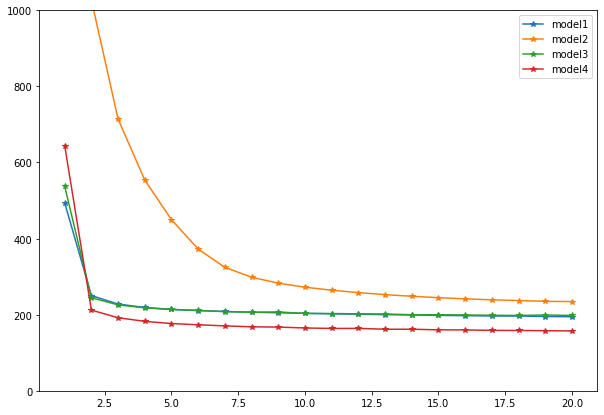

In [23]:
#epochs - mse graph
epochs = np.arange(1, 21)
plt.figure(figsize=(10, 7))
plt.plot(epochs, history1.history['mse'],'-*', label='model1')
plt.plot(epochs, history2.history['mse'],'-*', label='model2')
plt.plot(epochs, history3.history['mse'],'-*', label='model3')
plt.plot(epochs, history4.history['mse'],'-*', label='model4')
plt.ylim((0, 1000))
plt.legend()
plt.show()

In [28]:
def Show_result(model, test_dataset, show_width, show_height, multy=True):
    recon_img = model.predict(test_dataset)
    score = model.evaluate(test_dataset)
    
    LR_list = []
    SR_list = []
    HR_list = []
    total_list = []
    
    img_num = 4
    img_sets = iter(test_dataset).get_next()
    
    for index in range(img_num):
        LR_list.append(array_to_img(img_sets[0][index]))
        SR_list.append(array_to_img(recon_img[index]))
        HR_list.append(array_to_img(img_sets[1][index]))
    
    for i in range(img_num):
        total_list.append(LR_list[i])
        total_list.append(SR_list[i])
        total_list.append(HR_list[i])
        
    rows = img_num
    cols = 3

    xlabels = ["LR", "SR", "HR"]
    
    if multy:
    
        fig = plt.figure(figsize=(16*2, 9*2))
        for i in range(rows):
            LR_img = LR_list[i]
            SR_img = SR_list[i]
            HR_img = HR_list[i]

            LR_ax = fig.add_subplot(rows, cols, i*3+1)
            SR_ax = fig.add_subplot(rows, cols, i*3+2)
            HR_ax = fig.add_subplot(rows, cols, i*3+3)

            LR_ax.imshow(LR_img)
            SR_ax.imshow(SR_img)
            HR_ax.imshow(HR_img)

            LR_ax.set_xlabel(xlabels[0])
            SR_ax.set_xlabel(xlabels[1])
            HR_ax.set_xlabel(xlabels[2])

        plt.show()
        
    else:
        
        for img in total_list:
            plt.figure(figsize=(16*0.8, 9*0.8))
            plt.imshow(img)
    
    print(score)

50/50 [==============================] - 3s 59ms/step - loss: 221.2146 - mse: 221.2146
[221.21458435058594, 221.21458435058594]


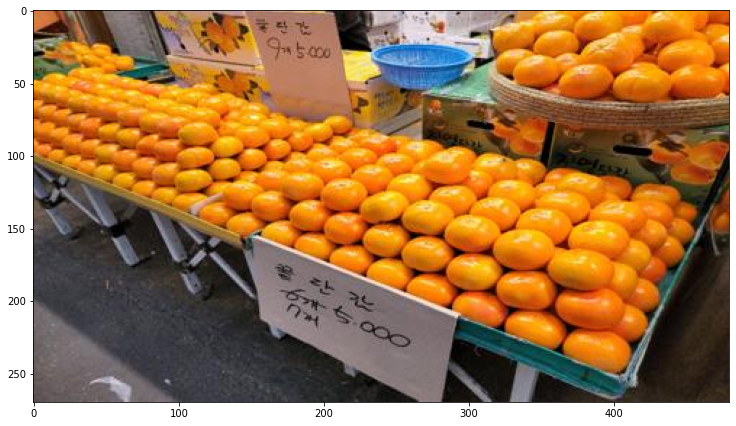

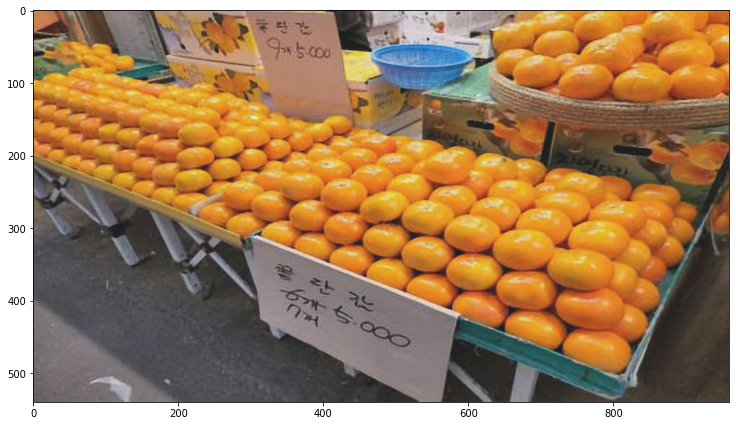

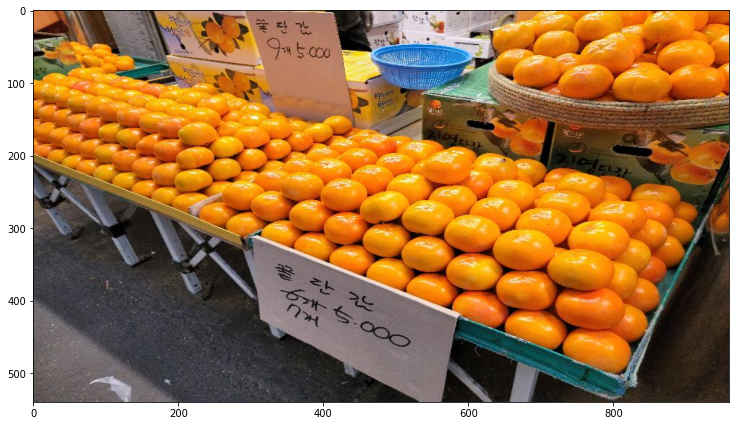

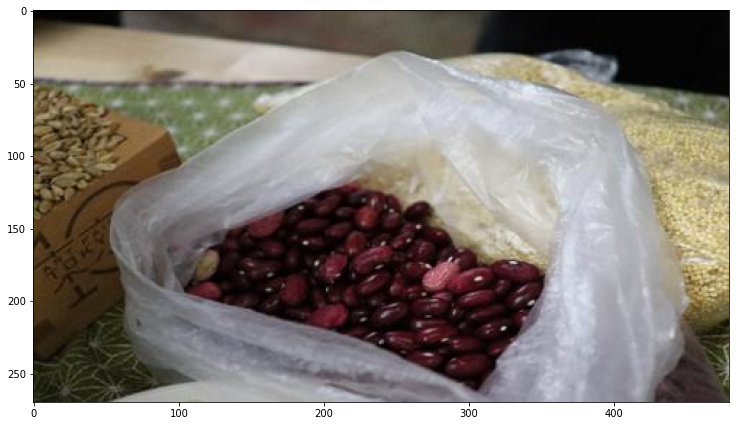

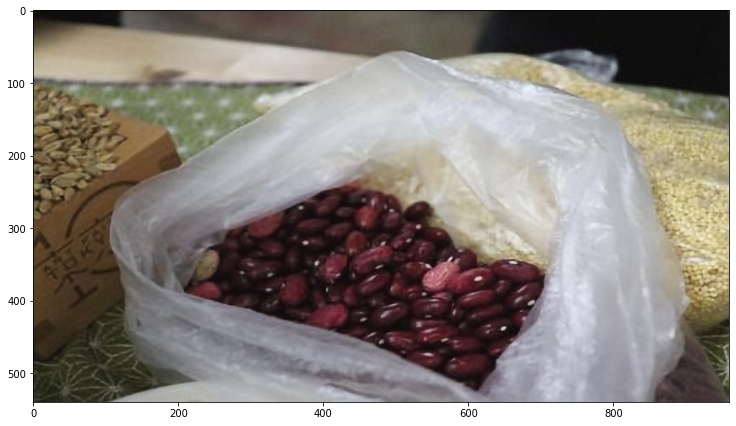

...

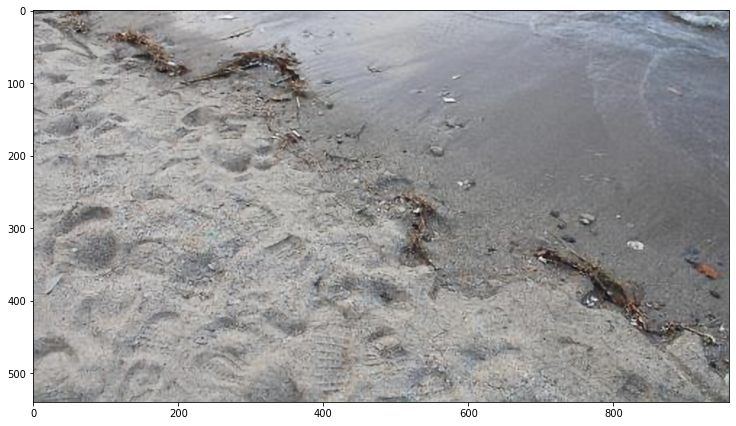

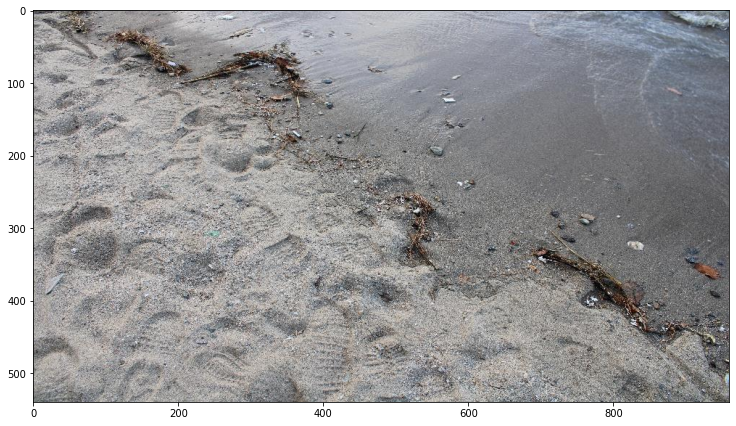

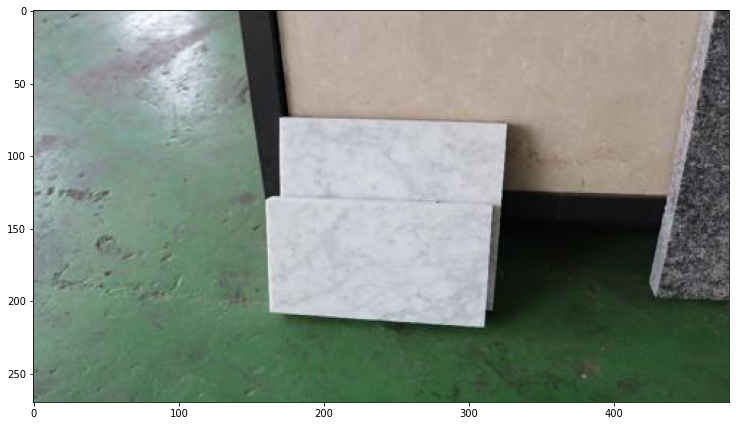

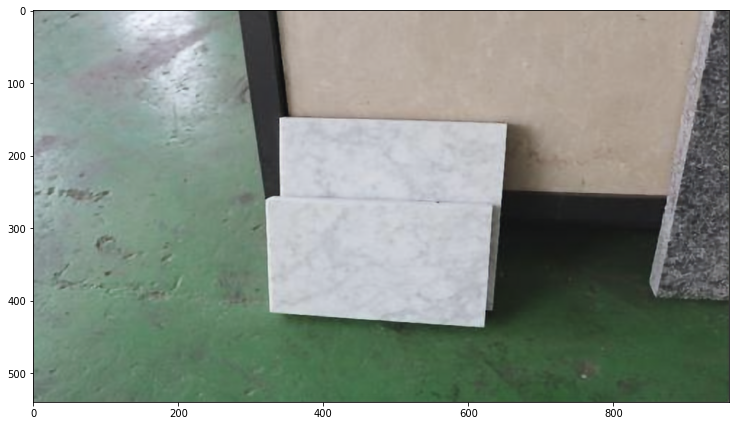

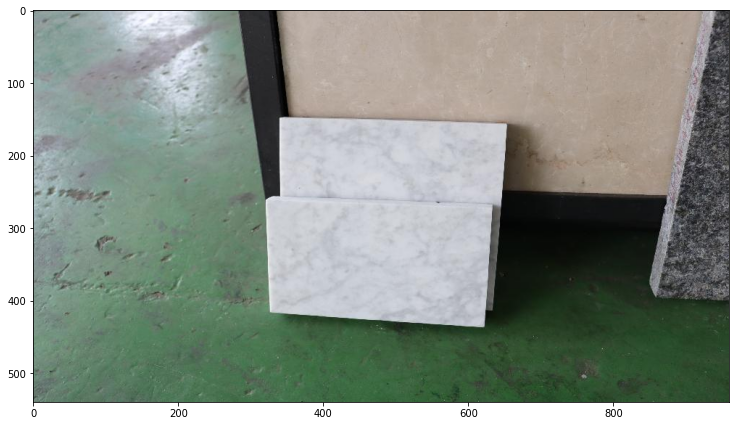

In [29]:
Show_result(my_model1, test_dataset, show_width, show_height, multy=False)

50/50 [==============================] - 6s 117ms/step - loss: 260.8230 - mse: 260.8230
[260.8230285644531, 260.822998046875]


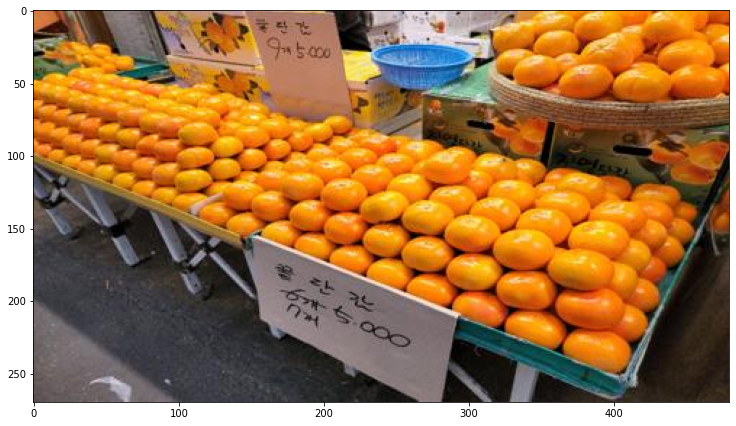

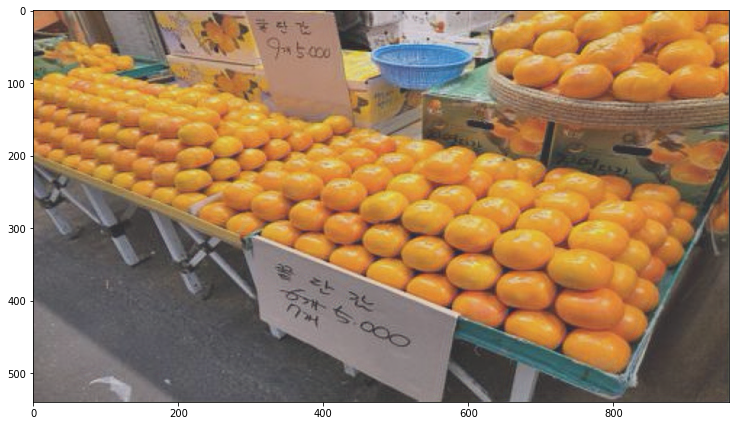

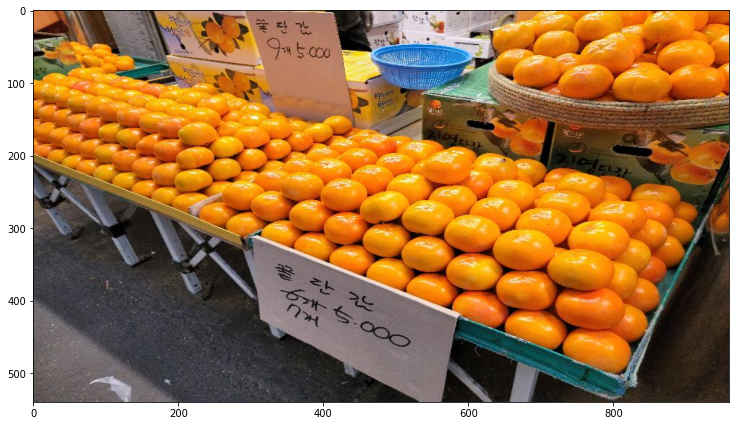

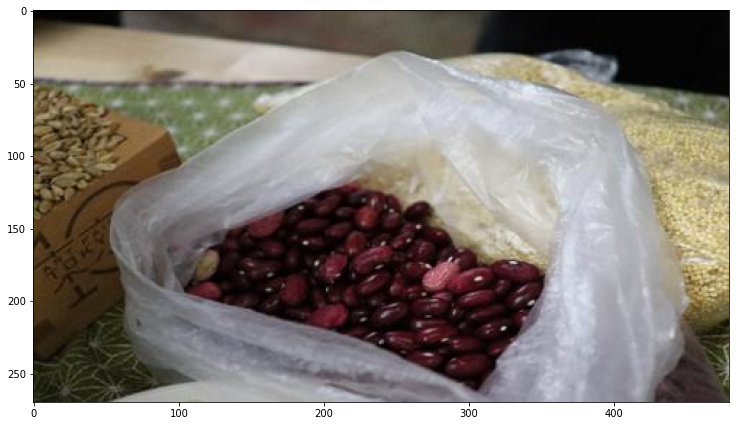

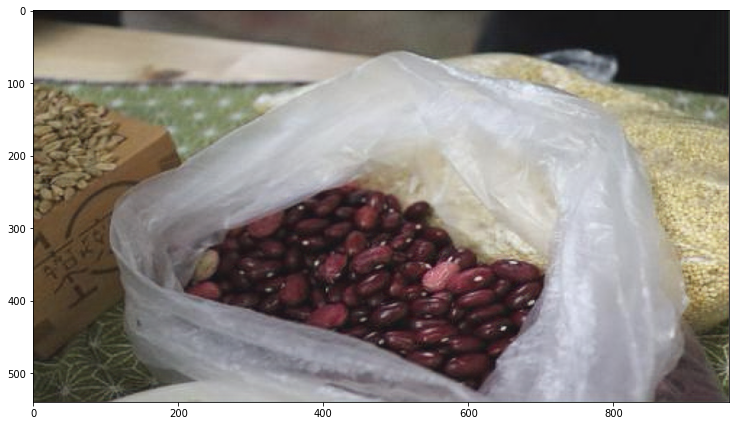

...

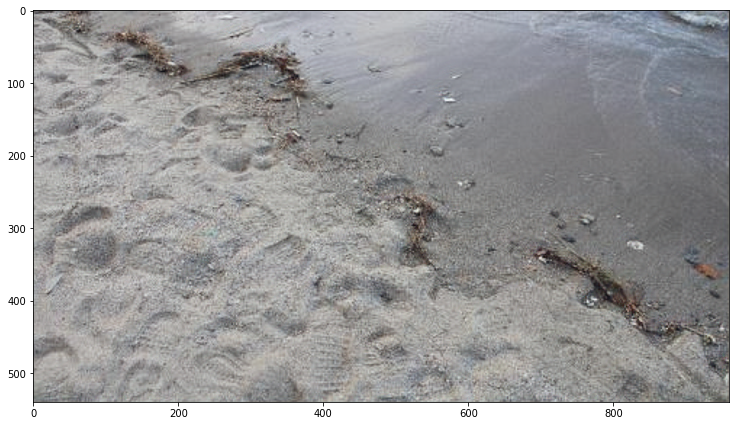

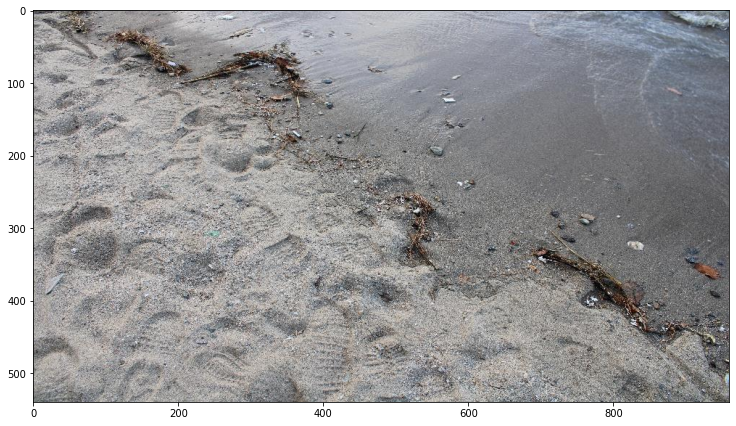

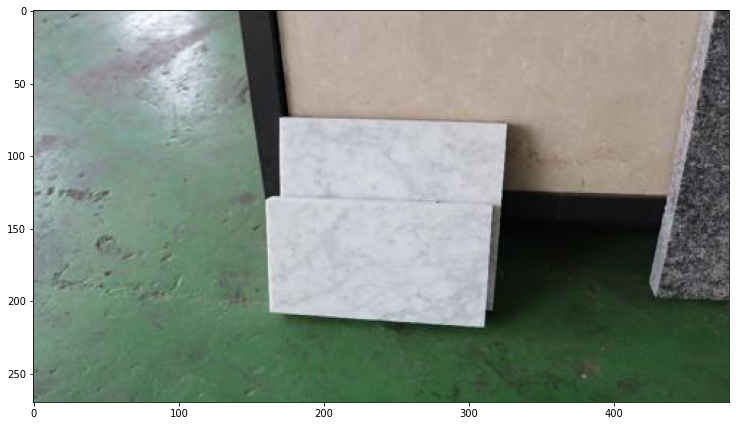

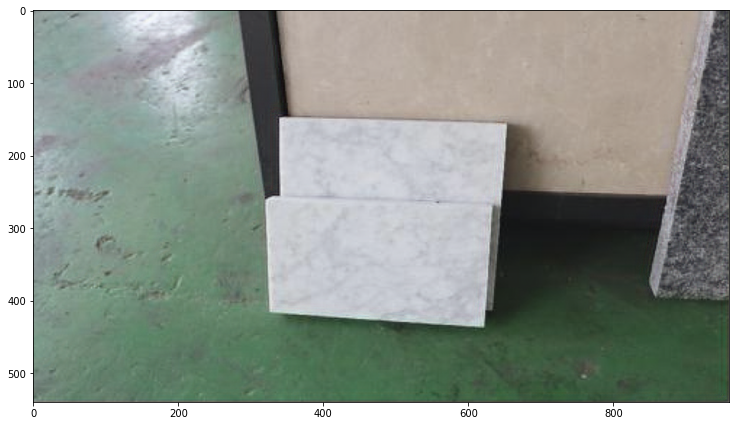

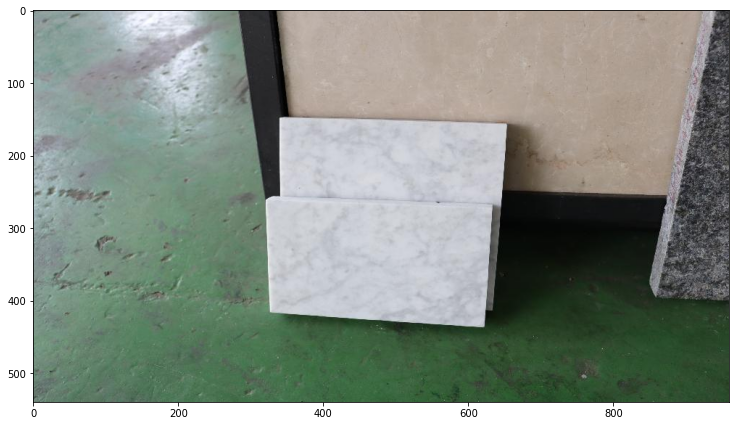

In [30]:
Show_result(my_model2, test_dataset, show_width, show_height, multy=False)

50/50 [==============================] - 7s 132ms/step - loss: 223.0119 - mse: 223.0119
[223.01194763183594, 223.01193237304688]


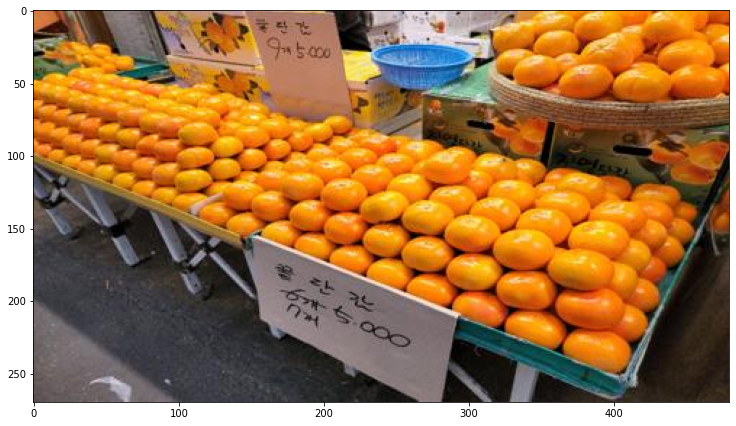

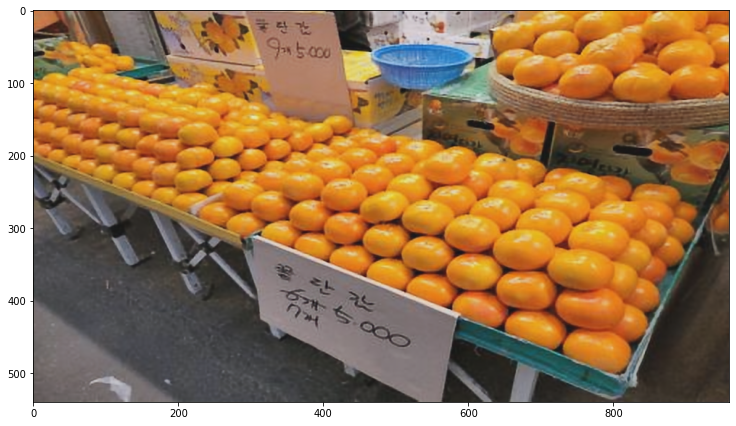

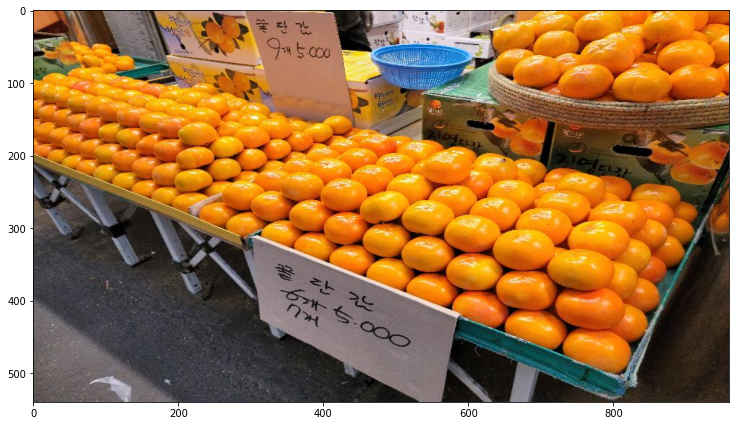

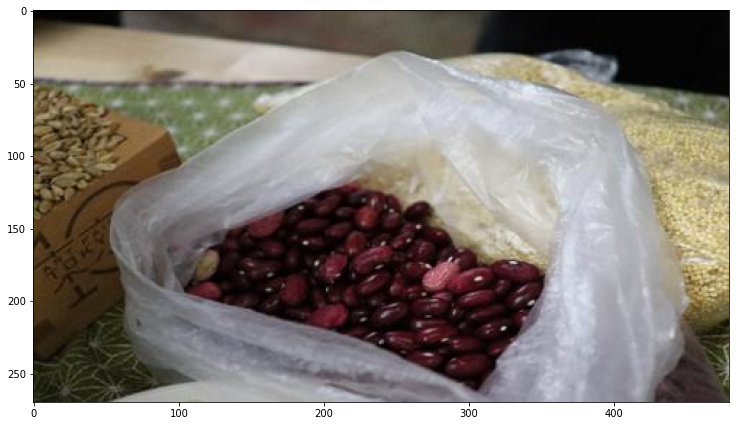

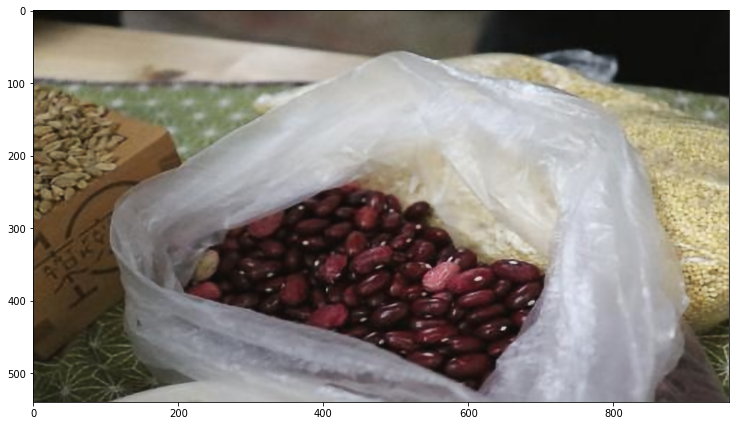

...

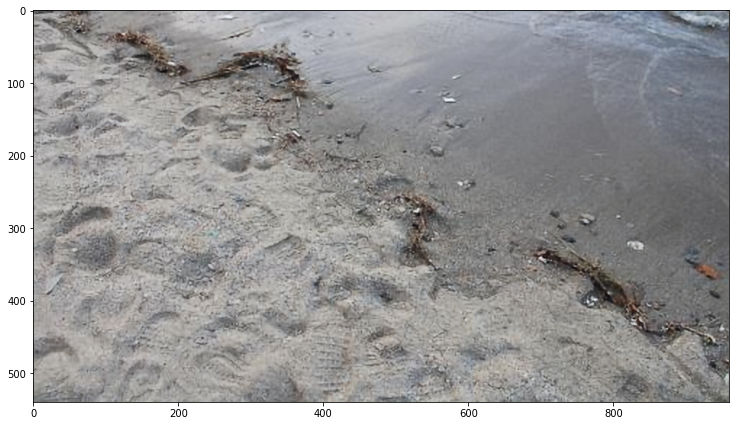

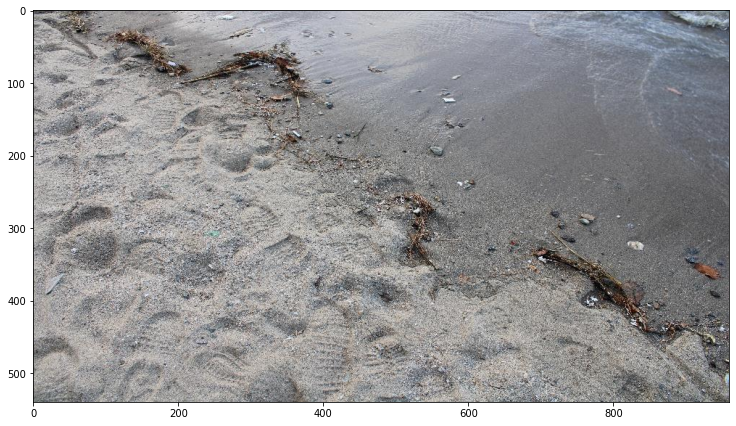

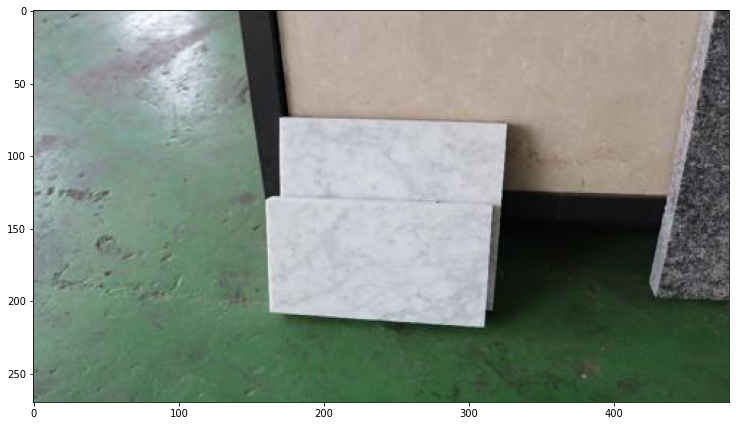

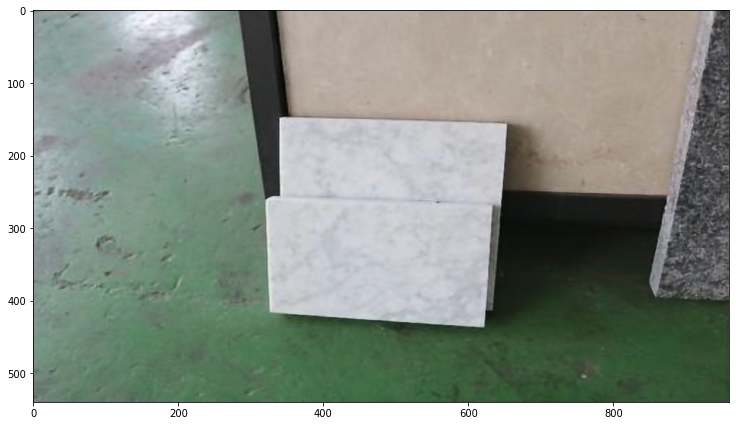

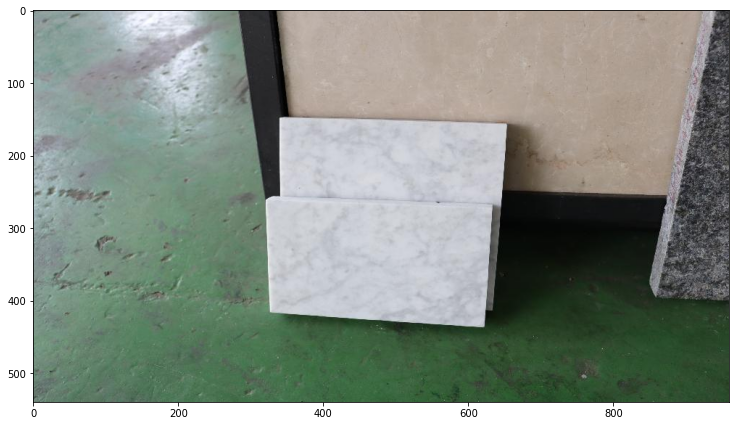

In [31]:
Show_result(my_model3, test_dataset, show_width, show_height, multy=False)

50/50 [==============================] - 7s 145ms/step - loss: 181.5215 - mse: 181.5216
[181.52149963378906, 181.52157592773438]


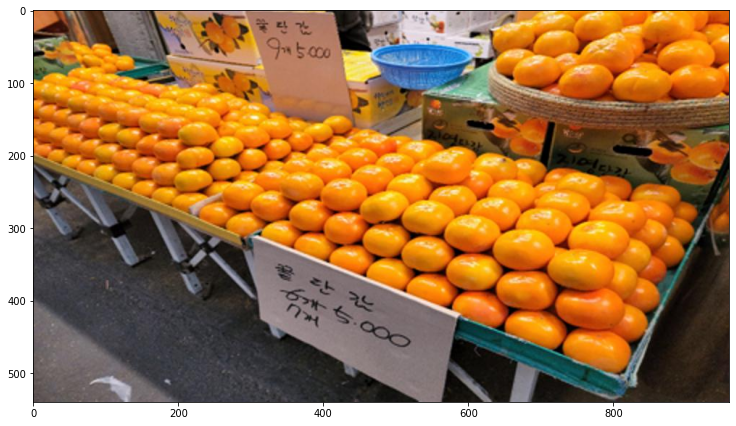

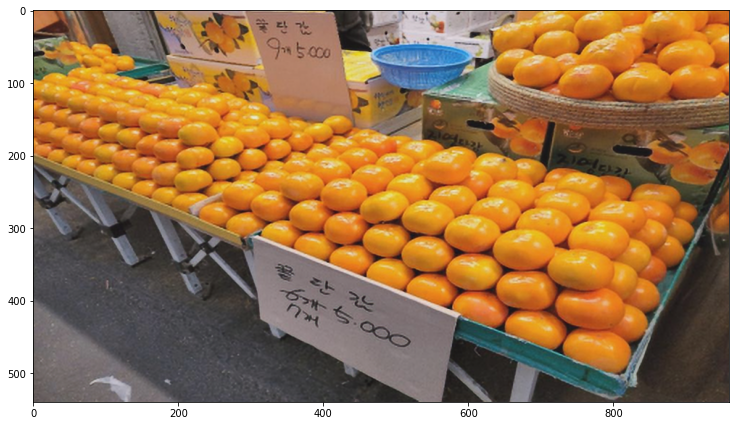

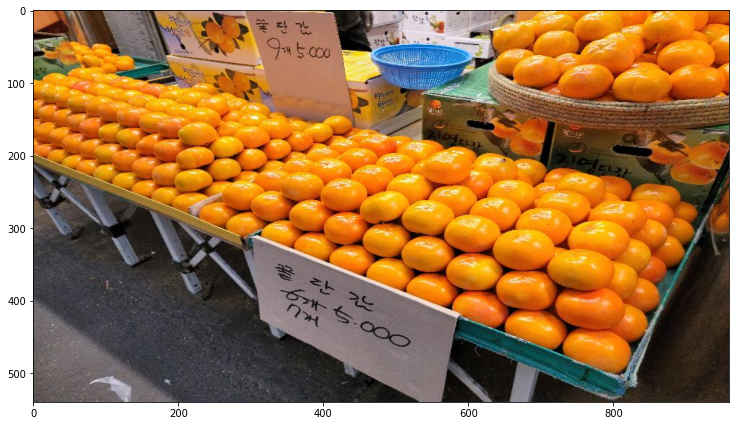

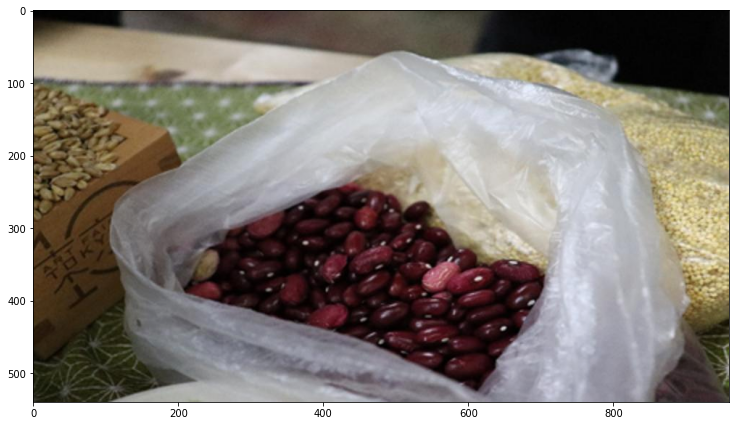

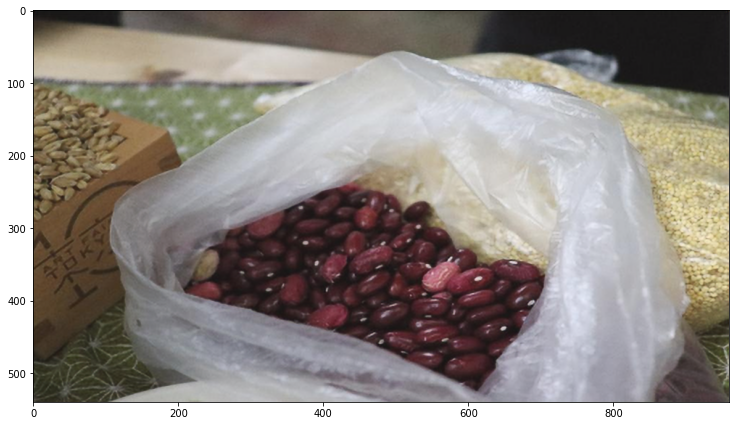

...

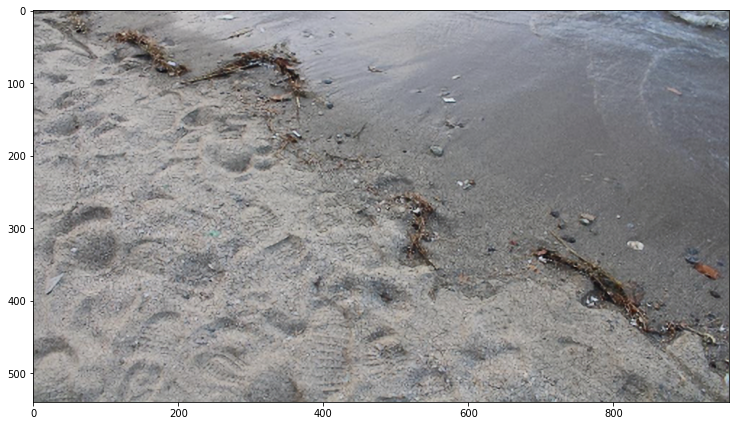

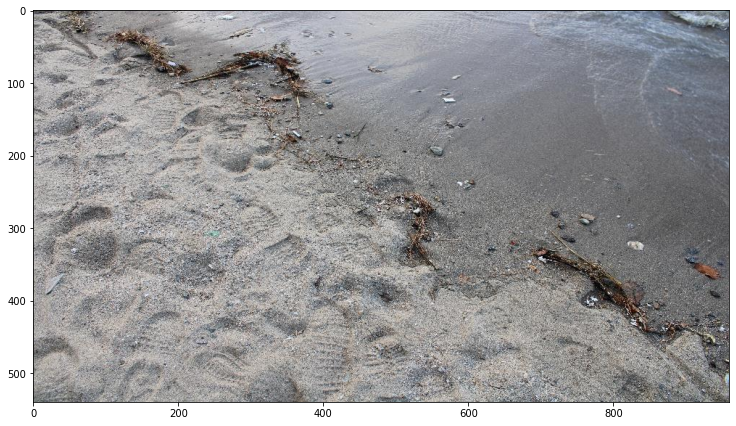

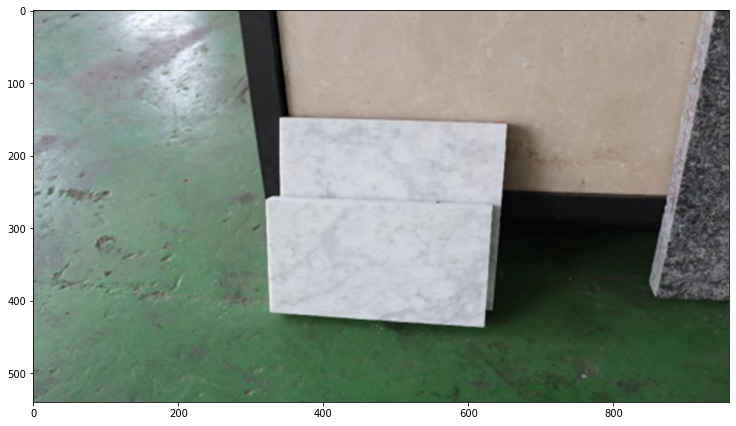

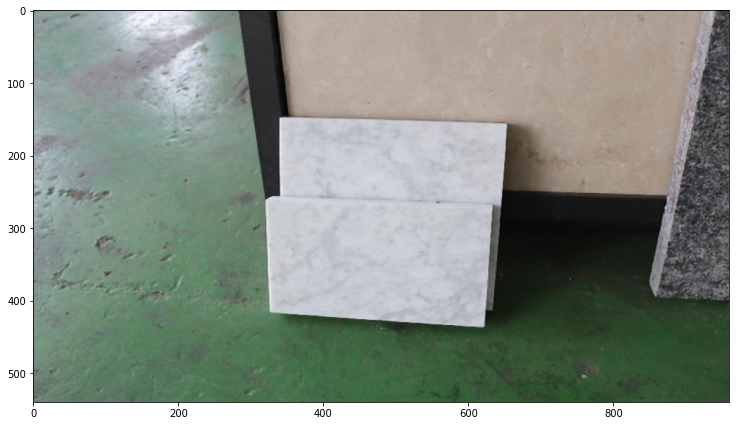

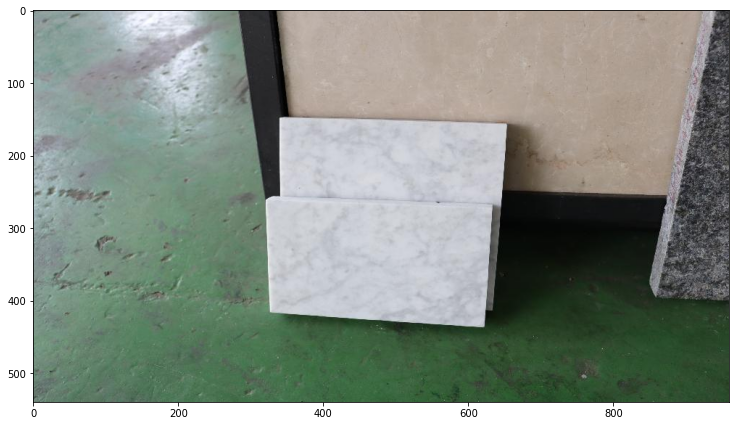

In [33]:
Show_result(my_model4, test_datasetBI, show_width, show_height, multy=False)

In [34]:
my_model1.save("model_weights/EDSR.h5")
my_model2.save("model_weights/K2R2.h5")
my_model3.save("model_weights/TCsr.h5")
my_model4.save("model_weights/BISR.h5")